# Assignment 2v: Traffic Sign Shape Detection
**Student:** Damian Cutajar
**Goal:** Train Faster RF-DETR to detect the traffic sign shapes.

IMPORTING NECESSARY LIBRARIES

In [1]:
# Imports and Setup
import os
import json
import torch
import torch.utils.data
import torchvision
from PIL import Image, ImageOps
from torchvision import transforms as T
import matplotlib.pyplot as plt
import matplotlib.patches as patches
import time
import pandas as pd
import numpy as np
from collections import Counter
from torchvision.datasets import CocoDetection
from rfdetr import RFDETRBase
import supervision as sv
import shutil
from pycocotools.coco import COCO
from PIL import Image, ImageOps
import torch.nn as nn
import seaborn as sns
from sklearn.metrics import confusion_matrix
import torchvision.ops as ops
from torchmetrics.detection.mean_ap import MeanAveragePrecision
from torchvision.ops import box_iou
from torch.utils.data import DataLoader

VERIFYING THE CUDA INSTALLATION AND GPU

In [2]:
print(torch.__version__)
print(torch.version.cuda)
print(torch.cuda.get_device_name())
print(torch.cuda.get_device_capability())
# Check device
device = torch.device('cuda') if torch.cuda.is_available() else torch.device('cpu')
print(f"Using device: {device}")

2.11.0.dev20260113+cu128
12.8
NVIDIA GeForce RTX 5070 Ti
(12, 0)
Using device: cuda


AI GENERATED SCRIPT TO ALLOW ME TO USE THE COCO DATASET WITH A ROBOTFLOW COCO STRUCTURE

In [3]:
SOURCE_DIR = r"C:\GitHub\CV2\Advanced-CV---Group-Assignment\ARI3129 - Assignment Materials\reissueswithmembermerger_ipynb\COCO-based_COCO_sign_shape"
OUTPUT_BASE = r"C:\GitHub\CV2\Advanced-CV---Group-Assignment\Scripts\Outputs\Damian\Shape_Detector"
FIXED_DATASET_DIR = os.path.join(OUTPUT_BASE, "RFDETR_Ready_Dataset")

In [4]:
def fix_dataset_complete(source, dest):
    print(f"🔧 Starting Complete Dataset Repair...")
    print(f"   Source: {source}")
    print(f"   Dest:   {dest}\n")

    if not os.path.exists(source):
        print(f"❌ CRITICAL ERROR: Source path not found!\n   Checked: {source}")
        return False

    # Clean destination
    if os.path.exists(dest):
        shutil.rmtree(dest)
    os.makedirs(dest)

    # Folder Mappings
    folder_map = {
        "train": "train",
        "val": "valid",
        "validation": "valid",
        "test": "test"
    }

    src_images = os.path.join(source, "images")
    src_annots = os.path.join(source, "annotations")

    if not os.path.exists(src_images):
        print(f"❌ Error: 'images' folder missing in source.")
        return False

    # Process each split (train, val, test)
    for original_split, target_split in folder_map.items():
        img_source_path = os.path.join(src_images, original_split)
        
        if os.path.exists(img_source_path):
            img_dest_path = os.path.join(dest, target_split)
            print(f"   📂 Copying images: {original_split} -> {target_split}")
            shutil.copytree(img_source_path, img_dest_path)

            possible_names = [f"{original_split}.json", f"{target_split}.json"]
            json_found = False
            
            for json_name in possible_names:
                json_src = os.path.join(src_annots, json_name)
                
                if os.path.exists(json_src):
                    json_dest = os.path.join(img_dest_path, "_annotations.coco.json")
                    
                    try:
                        with open(json_src, 'r') as f:
                            data = json.load(f)
                        
                        patched_count = 0
                        for category in data.get('categories', []):
                            if 'supercategory' not in category:
                                category['supercategory'] = "object"
                                patched_count += 1
                        
                        cats = data['categories']
                        current_ids = sorted([c['id'] for c in cats])
                        
                        id_map = {old_id: new_idx for new_idx, old_id in enumerate(current_ids)}
                        
                        for cat in cats:
                            cat['id'] = id_map[cat['id']]
                            
                        remapped_count = 0
                        for ann in data['annotations']:
                            old_eid = ann['category_id']
                            if old_eid in id_map:
                                ann['category_id'] = id_map[old_eid]
                                remapped_count += 1
                        
                        # Save
                        with open(json_dest, 'w') as f:
                            json.dump(data, f)
                            
                        print(f"      ✅ JSON Fixed: {json_name} -> _annotations.coco.json")
                        print(f"         - Patched 'supercategory': {patched_count} times")
                        print(f"         - Remapped IDs (0-indexed): {len(id_map)} categories, {remapped_count} annotations")
                        json_found = True
                        break
                        
                    except Exception as e:
                        print(f"      Error processing JSON: {e}")
            
            if not json_found:
                print(f"      Warning: No JSON found for {original_split}")

    print(f"\n✅ SUCCESS! Dataset is perfectly formatted at:\n   {dest}")
    return True


fix_dataset_complete(SOURCE_DIR, FIXED_DATASET_DIR)

🔧 Starting Complete Dataset Repair...
   Source: C:\GitHub\CV2\Advanced-CV---Group-Assignment\ARI3129 - Assignment Materials\reissueswithmembermerger_ipynb\COCO-based_COCO_sign_shape
   Dest:   C:\GitHub\CV2\Advanced-CV---Group-Assignment\Scripts\Outputs\Damian\Shape_Detector\RFDETR_Ready_Dataset

   📂 Copying images: train -> train
      ✅ JSON Fixed: train.json -> _annotations.coco.json
         - Patched 'supercategory': 5 times
         - Remapped IDs (0-indexed): 5 categories, 800 annotations
   📂 Copying images: val -> valid
      ✅ JSON Fixed: val.json -> _annotations.coco.json
         - Patched 'supercategory': 5 times
         - Remapped IDs (0-indexed): 5 categories, 185 annotations
   📂 Copying images: test -> test
      ✅ JSON Fixed: test.json -> _annotations.coco.json
         - Patched 'supercategory': 5 times
         - Remapped IDs (0-indexed): 5 categories, 175 annotations

✅ SUCCESS! Dataset is perfectly formatted at:
   C:\GitHub\CV2\Advanced-CV---Group-Assignment\S

True

DEFINING DATASET FOLDERS

In [5]:
# Initialize Data and Model
# PATH CONFIGURATION
DATASET_DIR = FIXED_DATASET_DIR
OUTPUT_DIR = os.path.join("Outputs", "Damian", "Shape_Detector","RUN2")
os.makedirs(OUTPUT_DIR, exist_ok=True)

INITIALISING MODEL

In [6]:
print(f"📂 Training on data from: {DATASET_DIR}")
model = RFDETRBase(model_size="base")

print(f"🚀 Model initialized on {device}")

📂 Training on data from: C:\GitHub\CV2\Advanced-CV---Group-Assignment\Scripts\Outputs\Damian\Shape_Detector\RFDETR_Ready_Dataset
Loading pretrain weights
🚀 Model initialized on cuda


In [7]:
print("🚀 Starting Training...")
model.train(
    dataset_dir=DATASET_DIR,
    output_dir=OUTPUT_DIR,
    epochs=100,
    batch_size=8,
    learning_rate=1e-4
)

print(f"🎉 Training Complete! Model saved to: {OUTPUT_DIR}")

🚀 Starting Training...
TensorBoard logging initialized. To monitor logs, use 'tensorboard --logdir Outputs\Damian\Shape_Detector\RUN2' and open http://localhost:6006/ in browser.
Not using distributed mode
git:
  sha: N/A, status: clean, branch: N/A

Namespace(num_classes=5, grad_accum_steps=4, amp=True, lr=0.0001, lr_encoder=0.00015, batch_size=8, weight_decay=0.0001, epochs=100, lr_drop=100, clip_max_norm=0.1, lr_vit_layer_decay=0.8, lr_component_decay=0.7, do_benchmark=False, dropout=0, drop_path=0.0, drop_mode='standard', drop_schedule='constant', cutoff_epoch=0, pretrained_encoder=None, pretrain_weights='rf-detr-base.pth', pretrain_exclude_keys=None, pretrain_keys_modify_to_load=None, pretrained_distiller=None, encoder='dinov2_windowed_small', vit_encoder_num_layers=12, window_block_indexes=None, position_embedding='sine', out_feature_indexes=[2, 5, 8, 11], freeze_encoder=False, layer_norm=True, rms_norm=False, backbone_lora=False, force_no_pretrain=False, dec_layers=3, dim_feedfo

Epoch: [0]  [ 0/18]  eta: 0:09:56  lr: 0.000100  class_error: 72.73  loss: 12.0508 (12.0508)  loss_ce: 1.9152 (1.9152)  loss_bbox: 0.3518 (0.3518)  loss_giou: 0.7528 (0.7528)  loss_ce_0: 1.9337 (1.9337)  loss_bbox_0: 0.3525 (0.3525)  loss_giou_0: 0.7268 (0.7268)  loss_ce_1: 1.9363 (1.9363)  loss_bbox_1: 0.3526 (0.3526)  loss_giou_1: 0.7586 (0.7586)  loss_ce_enc: 1.8567 (1.8567)  loss_bbox_enc: 0.3734 (0.3734)  loss_giou_enc: 0.7404 (0.7404)  loss_ce_unscaled: 1.9152 (1.9152)  class_error_unscaled: 72.7273 (72.7273)  loss_bbox_unscaled: 0.0704 (0.0704)  loss_giou_unscaled: 0.3764 (0.3764)  cardinality_error_unscaled: 3880.8750 (3880.8750)  loss_ce_0_unscaled: 1.9337 (1.9337)  loss_bbox_0_unscaled: 0.0705 (0.0705)  loss_giou_0_unscaled: 0.3634 (0.3634)  cardinality_error_0_unscaled: 3895.5000 (3895.5000)  loss_ce_1_unscaled: 1.9363 (1.9363)  loss_bbox_1_unscaled: 0.0705 (0.0705)  loss_giou_1_unscaled: 0.3793 (0.3793)  cardinality_error_1_unscaled: 3887.8750 (3887.8750)  loss_ce_enc_unsca

TO SEE TENSORBOARD OPEN ANACONDAPROMPT  
conda activate ARI3129   
cd C:\GitHub\CV2\Advanced-CV---Group-Assignment\Scripts\Outputs\Damian>c  
tensorboard --logdir Shape_Detector  

VISUALISING TRAINED MODEL ON TEST DATASET

loading annotations into memory...
Done (t=0.00s)
creating index...
index created!
loading annotations into memory...
Done (t=0.00s)
creating index...
index created!
✅ Loaded Class Map: {0: 'Circular', 1: 'Damaged', 2: 'Octagonal', 3: 'Square', 4: 'Triangular'}
Re-initializing Model Architecture on cuda...
Loading pretrain weights
✅ Model unwrapped. Object type: <class 'rfdetr.models.lwdetr.LWDETR'>
Performing surgery to resize classification heads...
✅ Surgery complete. Heads resized to 5 classes.
📥 Loading Weights from: Outputs\Damian\Shape_Detector\RUN2\checkpoint_best_ema.pth
✅ Weights loaded successfully (strict=False)
Running Inference on 138 images...


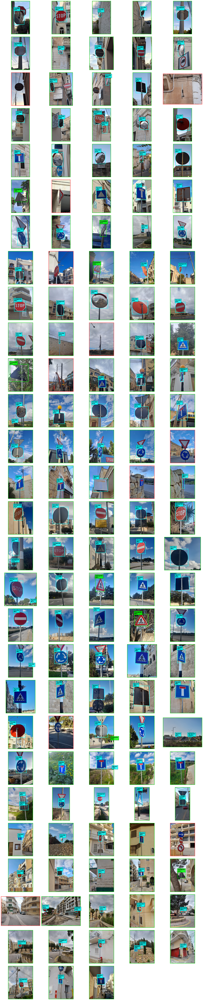

In [22]:
# CONFIGURATION

RUN_NAME = "RUN2"

OUTPUT_DIR = os.path.join("Outputs", "Damian", "Shape_Detector", RUN_NAME)
DATASET_DIR = FIXED_DATASET_DIR

# CLASS-SPECIFIC THRESHOLDS
CLASS_THRESHOLDS = {    
    'Circular': 0.8, 
    'Square': 0.6, 
    'Octagonal': 0.7,
    'Triangular': 0.55,  # Kept low because it was struggling
    'Damaged': 0.6,
    'default': 1.0
}

# VISUALS
COLOR_BOX = '#00FF00'     
COLOR_TEXT_BG = (0, 0, 0, 0.6) 
COLOR_BORDER_HIT = '#00CC00'   
COLOR_BORDER_MISS = '#FF3333'   

device = torch.device('cuda' if torch.cuda.is_available() else 'cpu')

# LOAD CORRECT CLASS MAPPING
TEST_IMG_DIR = os.path.join(DATASET_DIR, "test")
TEST_JSON = os.path.join(DATASET_DIR, "test", "_annotations.coco.json")
TRAIN_JSON = os.path.join(DATASET_DIR, "train", "_annotations.coco.json")

# Load Test Images
coco_test = COCO(TEST_JSON)
image_ids = coco_test.getImgIds()

# Load Train Categories
coco_train = COCO(TRAIN_JSON)
cats = coco_train.loadCats(coco_train.getCatIds())
# Sort by ID to ensure mapping aligns with model output indices
sorted_cats = sorted(cats, key=lambda x: x['id'])
class_map = {i: cat['name'] for i, cat in enumerate(sorted_cats)}

print(f"✅ Loaded Class Map: {class_map}")

print(f"Re-initializing Model Architecture on {device}...")

# Create the Wrapper
# Ensure imports are present for this block specifically
from rfdetr import RFDETRBase
import torch.nn as nn

base_wrapper = RFDETRBase(model_size="base", num_classes=5) 

# Extract the actual PyTorch Network
# We check base_wrapper
if hasattr(base_wrapper, 'model'):
    inference_model = base_wrapper.model
else:
    inference_model = base_wrapper

# Ensure it is a PyTorch Module
if not isinstance(inference_model, nn.Module):
    if hasattr(inference_model, 'model'):
        inference_model = inference_model.model

print(f"✅ Model unwrapped. Object type: {type(inference_model)}")

print("Performing surgery to resize classification heads...")

hidden_dim = 256 
target_classes = 5

if hasattr(inference_model, 'class_embed'):
    inference_model.class_embed = nn.Linear(hidden_dim, target_classes)

if hasattr(inference_model, 'transformer') and hasattr(inference_model.transformer, 'enc_out_class_embed'):
    # Create a new list of layers with the correct size
    num_layers = len(inference_model.transformer.enc_out_class_embed)
    new_enc_out = nn.ModuleList([
        nn.Linear(hidden_dim, target_classes) for _ in range(num_layers)
    ])
    inference_model.transformer.enc_out_class_embed = new_enc_out

print(f"✅ Surgery complete. Heads resized to {target_classes} classes.")
# LOAD THE BEST MODEL

checkpoint_path = os.path.join(OUTPUT_DIR, "checkpoint_best_ema.pth")

print(f"📥 Loading Weights from: {checkpoint_path}")
checkpoint = torch.load(checkpoint_path, map_location=device, weights_only=False)
state_dict = checkpoint.get('model', checkpoint.get('model_state_dict', checkpoint.get('state_dict', checkpoint)))

clean_state_dict = {}
for k, v in state_dict.items():
    if k.startswith('model.'):
        clean_state_dict[k[6:]] = v
    else:
        clean_state_dict[k] = v

try:
    # Load directly into the unwrapped inference_model
    inference_model.load_state_dict(clean_state_dict, strict=False)
    print("✅ Weights loaded successfully (strict=False)")
except Exception as e:
    print(f"❌ Error loading weights: {e}")

inference_model.eval()
inference_model.to(device)

# INFERENCE LOOP
eval_transform = T.Compose([
    T.Resize((672, 672)), 
    T.ToTensor(),
])

gt_counts = Counter()
pred_counts = Counter()
results_buffer = []

print(f"Running Inference on {len(image_ids)} images...")

with torch.no_grad():
    for img_id in image_ids:
        img_info = coco_test.loadImgs(img_id)[0]
        img_path = os.path.join(TEST_IMG_DIR, img_info['file_name'])
        
        # Load & Fix Rotation
        original_image = Image.open(img_path).convert("RGB")
        original_image = ImageOps.exif_transpose(original_image)
        w, h = original_image.size 
        
        img_tensor = eval_transform(original_image).unsqueeze(0).to(device)
        
        # Ground Truth Stats
        ann_ids = coco_test.getAnnIds(imgIds=img_id)
        anns = coco_test.loadAnns(ann_ids)
        for ann in anns:
            cat_name = [c['name'] for c in cats if c['id'] == ann['category_id']][0]
            gt_counts[cat_name] += 1
            
        # Prediction
        outputs = inference_model(img_tensor)
        
        if isinstance(outputs, dict):
            logits = outputs['pred_logits']
            boxes = outputs['pred_boxes']
        else:
            logits, boxes = outputs

        probas = logits.sigmoid()[0] 
        
        # Get top class and score for every box proposal
        top_scores, top_labels = probas.max(-1)
        
        # APPLY DYNAMIC THRESHOLDS
        keep_indices = []
        for i, (score, lbl) in enumerate(zip(top_scores, top_labels)):
            class_name = class_map.get(lbl.item(), "Unknown")
            thresh = CLASS_THRESHOLDS.get(class_name, CLASS_THRESHOLDS['default'])
            
            if score > thresh:
                keep_indices.append(i)
        
        # Filter boxes
        if keep_indices:
            keep = torch.tensor(keep_indices, dtype=torch.long)
            bboxes_scaled = boxes[0, keep].cpu()
            final_scores = top_scores[keep].cpu().numpy()
            final_labels = top_labels[keep].cpu().numpy()
            
            # Scale boxes
            c_x, c_y, bw, bh = bboxes_scaled.unbind(-1)
            x1 = (c_x - 0.5 * bw) * w
            y1 = (c_y - 0.5 * bh) * h
            x2 = (c_x + 0.5 * bw) * w
            y2 = (c_y + 0.5 * bh) * h
            
            final_boxes = torch.stack([x1, y1, x2, y2], dim=1).numpy()
        else:
            final_boxes = np.array([])
            final_scores = np.array([])
            final_labels = np.array([])

        # Record Stats
        found_any = False
        if len(final_labels) > 0:
            found_any = True
            for lbl in final_labels:
                pred_counts[class_map.get(lbl, "Unknown")] += 1
            
        results_buffer.append({
            'img': original_image,
            'boxes': final_boxes,
            'labels': final_labels,
            'scores': final_scores,
            'found': found_any
        })

# RENDER
cols = 5
rows = int(np.ceil(len(results_buffer) / cols))
fig_height = max(4, rows * 3.5)

fig, axes = plt.subplots(rows, cols, figsize=(20, fig_height))
axes = axes.ravel() if len(results_buffer) > 1 else [axes]

for i, ax in enumerate(axes):
    if i >= len(results_buffer):
        ax.axis('off')
        continue
    res = results_buffer[i]
    ax.imshow(res['img'])
    ax.set_xticks([])
    ax.set_yticks([])
    
    border = COLOR_BORDER_HIT if res['found'] else COLOR_BORDER_MISS
    for spine in ax.spines.values():
        spine.set_edgecolor(border)
        spine.set_linewidth(2)

    if len(res['boxes']) > 0:
        for j, box in enumerate(res['boxes']):
            x1, y1, x2, y2 = box
            label_idx = res['labels'][j]
            label_name = class_map.get(label_idx, "Unknown")
            score = res['scores'][j]
            
            # Highlight Triangles specifically
            color = '#00FF00' if label_name == 'Triangular' else 'cyan'
            
            rect = patches.Rectangle((x1, y1), x2-x1, y2-y1, linewidth=2, edgecolor=color, facecolor='none')
            ax.add_patch(rect)
            ax.text(x1, y1, f"{label_name}\n{score:.0%}", color='black', fontsize=9, weight='bold', bbox=dict(facecolor=color, alpha=0.8))

plt.tight_layout()
plt.show()

Predicitions Counter


📈 Generating Analysis...


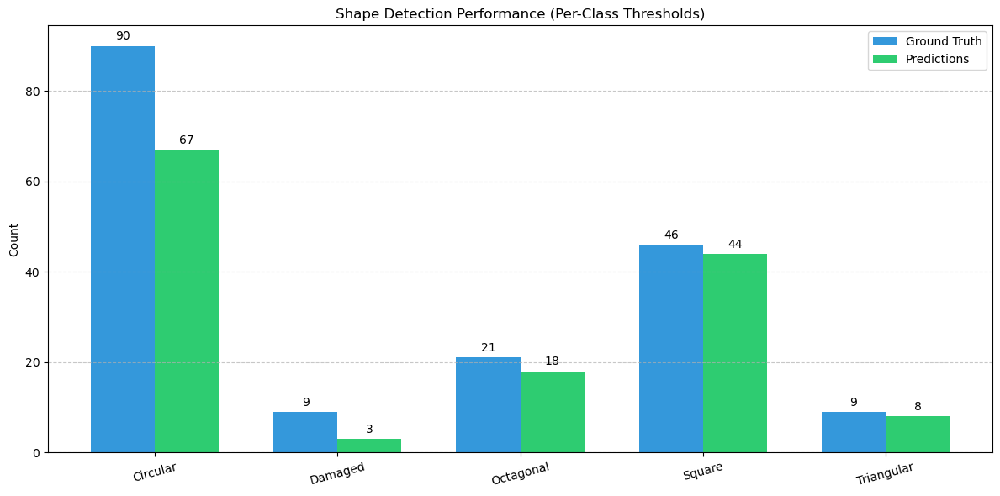

In [23]:
# GRAPH
print("\n📈 Generating Analysis...")
sorted_names = [class_map[i] for i in sorted(class_map.keys())]

gt_vals = [gt_counts[c] for c in sorted_names]
pred_vals = [pred_counts[c] for c in sorted_names]

x = np.arange(len(sorted_names))
width = 0.35

fig, ax = plt.subplots(figsize=(12, 6))
rects1 = ax.bar(x - width/2, gt_vals, width, label='Ground Truth', color='#3498db')
rects2 = ax.bar(x + width/2, pred_vals, width, label='Predictions', color='#2ecc71')

ax.set_ylabel('Count')
ax.set_title('Shape Detection Performance (Per-Class Thresholds)')
ax.set_xticks(x)
ax.set_xticklabels(sorted_names, rotation=15)
ax.legend()
ax.grid(axis='y', linestyle='--', alpha=0.7)

def autolabel(rects):
    for rect in rects:
        height = rect.get_height()
        ax.annotate(f'{height}',
                    xy=(rect.get_x() + rect.get_width() / 2, height),
                    xytext=(0, 3), textcoords="offset points",
                    ha='center', va='bottom')

autolabel(rects1)
autolabel(rects2)
plt.tight_layout()
plt.show()

📊 Generating Confusion Matrix with Per-Class Thresholds...
   Settings: {'Circular': 0.8, 'Square': 0.6, 'Octagonal': 0.7, 'Triangular': 0.55, 'Damaged': 0.6, 'Background': 1}


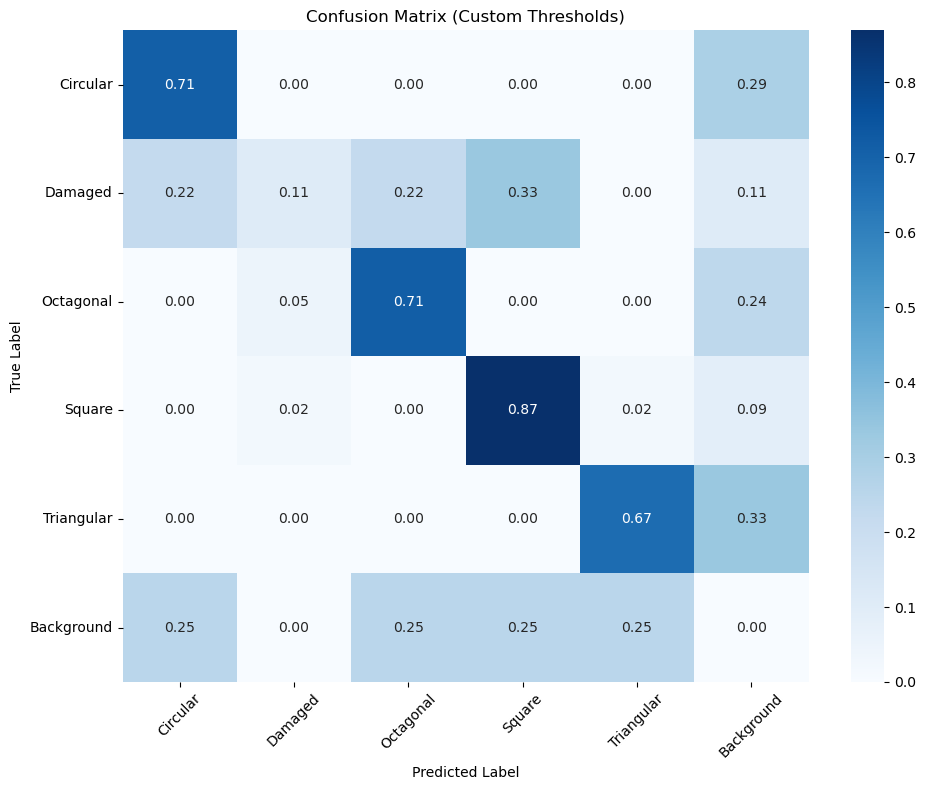


🔍 Raw Counts (Rows=True, Cols=Pred):
            Circular  Damaged  Octagonal  Square  Triangular  Background
Circular          64        0          0       0           0          26
Damaged            2        1          2       3           0           1
Octagonal          0        1         15       0           0           5
Square             0        1          0      40           1           4
Triangular         0        0          0       0           6           3
Background         1        0          1       1           1           0


In [24]:
THRESHOLDS_DICT = {
    'Circular': 0.8, 
    'Square': 0.6, 
    'Octagonal': 0.7,
    'Triangular': 0.55,  # Kept low because it was struggling
    'Damaged': 0.6,
    'Background': 1
}
DEFAULT_THRESH = 0.55

IOU_THRESHOLD = 0.5 

# Setup Class Names
class_names = [class_map[i] for i in sorted(class_map.keys())]
class_names_plus_bg = class_names + ['Background']
bg_idx = len(class_names)

thresh_list = []
for i in range(len(class_names)):
    name = class_names[i]
    thresh_list.append(THRESHOLDS_DICT.get(name, DEFAULT_THRESH))
    
threshold_tensor = torch.tensor(thresh_list).to(device)

y_true = []
y_pred = []

print(f"📊 Generating Confusion Matrix with Per-Class Thresholds...")
print(f"   Settings: {THRESHOLDS_DICT}")

inference_model.eval()

with torch.no_grad():
    for img_id in image_ids:
        img_info = coco_test.loadImgs(img_id)[0]
        img_path = os.path.join(TEST_IMG_DIR, img_info['file_name'])
        original_image = Image.open(img_path).convert("RGB")
        original_image = ImageOps.exif_transpose(original_image)
        w, h = original_image.size 
        img_tensor = eval_transform(original_image).unsqueeze(0).to(device)

        ann_ids = coco_test.getAnnIds(imgIds=img_id)
        anns = coco_test.loadAnns(ann_ids)
        
        gt_boxes = []
        gt_labels = []
        for ann in anns:
            x, y, bw, bh = ann['bbox']
            gt_boxes.append([x, y, x + bw, y + bh])
            cat_name = [c['name'] for c in cats if c['id'] == ann['category_id']][0]
            internal_idx = list(class_map.values()).index(cat_name)
            gt_labels.append(internal_idx)
            
        gt_boxes = torch.tensor(gt_boxes, dtype=torch.float32).to(device)
        gt_labels = torch.tensor(gt_labels, dtype=torch.long).to(device)

        outputs = inference_model(img_tensor)
        if isinstance(outputs, dict):
            logits = outputs['pred_logits']
            boxes = outputs['pred_boxes']
        else:
            logits, boxes = outputs

        probas = logits.sigmoid()[0]
        top_scores, top_labels = probas.max(-1)
        
        # Scale boxes
        bboxes_scaled = boxes[0].cpu()
        c_x, c_y, bw, bh = bboxes_scaled.unbind(-1)
        x1 = (c_x - 0.5 * bw) * w
        y1 = (c_y - 0.5 * bh) * h
        x2 = (c_x + 0.5 * bw) * w
        y2 = (c_y + 0.5 * bh) * h
        pred_boxes_all = torch.stack([x1, y1, x2, y2], dim=1).to(device)
        
        # DYNAMIC THRESHOLD FILTERING
        required_thresholds = threshold_tensor[top_labels]
        
        # Keep only predictions that beat their SPECIFIC class threshold
        keep = top_scores > required_thresholds
        
        pred_boxes = pred_boxes_all[keep]
        pred_labels = top_labels[keep]

        if len(gt_boxes) == 0 and len(pred_boxes) == 0:
            continue
            
        if len(pred_boxes) == 0:
            for lbl in gt_labels:
                y_true.append(lbl.item())
                y_pred.append(bg_idx)
            continue

        if len(gt_boxes) == 0:
            for lbl in pred_labels:
                y_true.append(bg_idx)
                y_pred.append(lbl.item())
            continue

        iou_matrix = ops.box_iou(gt_boxes, pred_boxes)
        gt_matched = set()
        pred_matched = set()

        iou_values, indices = torch.sort(iou_matrix.flatten(), descending=True)
        
        for idx, iou in zip(indices, iou_values):
            if iou < IOU_THRESHOLD:
                break
            gt_idx = (idx // iou_matrix.shape[1]).item()
            pred_idx = (idx % iou_matrix.shape[1]).item()

            if gt_idx in gt_matched or pred_idx in pred_matched:
                continue

            y_true.append(gt_labels[gt_idx].item())
            y_pred.append(pred_labels[pred_idx].item())
            gt_matched.add(gt_idx)
            pred_matched.add(pred_idx)

        for i in range(len(gt_labels)):
            if i not in gt_matched:
                y_true.append(gt_labels[i].item())
                y_pred.append(bg_idx)

        for i in range(len(pred_labels)):
            if i not in pred_matched:
                y_true.append(bg_idx)
                y_pred.append(pred_labels[i].item())

# Plotting
cm = confusion_matrix(y_true, y_pred, labels=range(len(class_names_plus_bg)))
cm_norm = cm.astype('float') / cm.sum(axis=1)[:, np.newaxis]
cm_norm = np.nan_to_num(cm_norm)

plt.figure(figsize=(10, 8))
sns.heatmap(cm_norm, annot=True, fmt='.2f', cmap='Blues',
            xticklabels=class_names_plus_bg, yticklabels=class_names_plus_bg)

plt.xlabel('Predicted Label')
plt.ylabel('True Label')
plt.title(f'Confusion Matrix (Custom Thresholds)')
plt.xticks(rotation=45)
plt.yticks(rotation=0)
plt.tight_layout()
plt.show()

print("\n🔍 Raw Counts (Rows=True, Cols=Pred):")
print(pd.DataFrame(cm, index=class_names_plus_bg, columns=class_names_plus_bg))

EVALUATION METRICS

In [25]:
RUN_NAME = "RUN2"
OUTPUT_DIR = os.path.join("Outputs", "Damian", "Shape_Detector", RUN_NAME)
DATASET_DIR = FIXED_DATASET_DIR 

device = torch.device('cuda' if torch.cuda.is_available() else 'cpu')

# Custom Shape Thresholds
CLASS_THRESHOLDS = {
    'Circular': 0.8, 
    'Square': 0.6, 
    'Octagonal': 0.7,
    'Triangular': 0.55,
    'Damaged': 0.6,
    'default': 1
}

# Transform (Resize to 672 for Model Input)
eval_transform = T.Compose([
    T.Resize((672, 672)),
    T.ToTensor(),
])

TEST_IMG_DIR = os.path.join(DATASET_DIR, "test")
TEST_JSON = os.path.join(DATASET_DIR, "test", "_annotations.coco.json")
TRAIN_JSON = os.path.join(DATASET_DIR, "train", "_annotations.coco.json")

# Load Class Names
coco_train = COCO(TRAIN_JSON)
cats = coco_train.loadCats(coco_train.getCatIds())
sorted_cats = sorted(cats, key=lambda x: x['id'])
idx_to_name = {i: cat['name'] for i, cat in enumerate(sorted_cats)}
coco_id_to_model_idx = {cat['id']: i for i, cat in enumerate(sorted_cats)}

class COCOFormatted(CocoDetection):
    def __getitem__(self, index):
        img, target = super().__getitem__(index)
        
        # 1. Capture ORIGINAL size before resizing
        w_orig, h_orig = img.size 
        
        # 2. Resize Image for Model
        img = eval_transform(img)
        
        # 3. Format Target
        boxes = []
        labels = []
        for ann in target:
            x, y, w, h = ann['bbox']
            boxes.append([x, y, x + w, y + h])
            labels.append(ann['category_id']) 
            
        target_dict = {}
        target_dict['image_id'] = torch.tensor([index])
        target_dict['boxes'] = torch.tensor(boxes, dtype=torch.float32) if boxes else torch.zeros((0, 4))
        target_dict['labels'] = torch.tensor(labels, dtype=torch.int64) if labels else torch.zeros((0,), dtype=torch.int64)
        
        # 4. Pass ORIGINAL size so we scale predictions up to match GT
        target_dict['size'] = torch.tensor([h_orig, w_orig]) 
        target_dict['orig_size'] = torch.tensor([h_orig, w_orig])
        
        return img, target_dict

dataset_test = COCOFormatted(root=TEST_IMG_DIR, annFile=TEST_JSON)
data_loader_test = DataLoader(dataset_test, batch_size=4, shuffle=False, collate_fn=lambda x: tuple(zip(*x)))

# LOAD MODEL
print(f"🚀 Initializing Model on {device}...")
base_wrapper = RFDETRBase(model_size="base", num_classes=5) 

if hasattr(base_wrapper, 'model'):
    inference_model = base_wrapper.model
else:
    inference_model = base_wrapper

if not isinstance(inference_model, nn.Module):
    if hasattr(inference_model, 'model'):
        inference_model = inference_model.model

# Resize Heads
hidden_dim = 256 
target_classes = 5
if hasattr(inference_model, 'class_embed'):
    inference_model.class_embed = nn.Linear(hidden_dim, target_classes)
if hasattr(inference_model, 'transformer') and hasattr(inference_model.transformer, 'enc_out_class_embed'):
    num_layers = len(inference_model.transformer.enc_out_class_embed)
    new_enc_out = nn.ModuleList([nn.Linear(hidden_dim, target_classes) for _ in range(num_layers)])
    inference_model.transformer.enc_out_class_embed = new_enc_out

# Load Weights
checkpoint_path = os.path.join(OUTPUT_DIR, "checkpoint_best_ema.pth")
checkpoint = torch.load(checkpoint_path, map_location=device, weights_only=False)
state_dict = checkpoint.get('model', checkpoint.get('model_state_dict', checkpoint.get('state_dict', checkpoint)))
clean_state_dict = {k.replace('model.', ''): v for k, v in state_dict.items()}

try:
    inference_model.load_state_dict(clean_state_dict, strict=False)
    print("✅ Weights loaded!")
except Exception as e:
    print(f"❌ Error loading weights: {e}")

inference_model.eval()
inference_model.to(device)

# EVALUATION LOOP
def process_detr_outputs(outputs, target_sizes):
    out_logits, out_bbox = outputs['pred_logits'], outputs['pred_boxes']
    prob = out_logits.softmax(-1)
    scores, labels = prob[..., :-1].max(-1)
    
    results = []
    for i, (boxes, s, l) in enumerate(zip(out_bbox, scores, labels)):
        x_c, y_c, w, h = boxes.unbind(-1)
        b = [(x_c - 0.5 * w), (y_c - 0.5 * h), (x_c + 0.5 * w), (y_c + 0.5 * h)]
        boxes = torch.stack(b, dim=-1)
        
        # Scale to ORIGINAL PIXELS using target_sizes
        img_h, img_w = target_sizes[i]
        scale_fct = torch.tensor([img_w, img_h, img_w, img_h], device=boxes.device)
        boxes = boxes * scale_fct
        
        results.append({'boxes': boxes, 'scores': s, 'labels': l})
    return results

print("🚀 Starting Evaluation...")
map_metric = MeanAveragePrecision(box_format='xyxy', iou_type='bbox', class_metrics=True)
inference_times = []
tp, fp, fn = 0, 0, 0

with torch.no_grad():
    for i, (images, targets) in enumerate(data_loader_test):
        images = torch.stack(images).to(device)
        
        start = time.time()
        outputs = inference_model(images)
        end = time.time()
        inference_times.append((end - start) * 1000 / len(images))

        # Pass ORIGINAL sizes for rescaling
        target_sizes = torch.stack([t['size'] for t in targets]).to(device)
        preds = process_detr_outputs(outputs, target_sizes)
        
        targets_cpu = []
        for t in targets:
            new_labels = torch.tensor([coco_id_to_model_idx.get(l.item(), -1) for l in t['labels']], dtype=torch.int64)
            targets_cpu.append({'boxes': t['boxes'].cpu(), 'labels': new_labels})

        preds_cpu = [{k: v.cpu() for k, v in p.items()} for p in preds]

        map_metric.update(preds_cpu, targets_cpu)

        # Custom Stats
        for p, t in zip(preds_cpu, targets_cpu):
            gt_boxes = t['boxes']
            gt_labels = t['labels']
            
            keep = []
            for idx, score in enumerate(p['scores']):
                lbl_idx = p['labels'][idx].item()
                class_name = idx_to_name.get(lbl_idx, 'default')
                thresh = CLASS_THRESHOLDS.get(class_name, CLASS_THRESHOLDS['default'])
                if score >= thresh:
                    keep.append(idx)
            
            if keep:
                k_idx = torch.tensor(keep, dtype=torch.long)
                p_boxes = p['boxes'][k_idx]
                p_labels = p['labels'][k_idx]
            else:
                p_boxes = torch.empty((0, 4)); p_labels = torch.empty((0,), dtype=torch.long)

            if len(gt_boxes) == 0: fp += len(p_boxes)
            elif len(p_boxes) == 0: fn += len(gt_boxes)
            else:
                ious = box_iou(gt_boxes, p_boxes)
                matched_p = set()
                for t_idx in range(len(gt_boxes)):
                    max_iou, p_idx = torch.max(ious[t_idx], dim=0)
                    p_idx = p_idx.item()
                    if max_iou > 0.5 and p_idx not in matched_p:
                        if p_labels[p_idx] == gt_labels[t_idx]: tp += 1
                        else: fp += 1; fn += 1
                        matched_p.add(p_idx)
                    else: fn += 1
                fp += (len(p_boxes) - len(matched_p))
        
        if i % 10 == 0: print(f"Batch {i} done...")

map_res = map_metric.compute()
precision = tp / (tp + fp + 1e-6)
recall = tp / (tp + fn + 1e-6)
f1 = 2 * (precision * recall) / (precision + recall + 1e-6)
latency = np.mean(inference_times)

print("\n" + "="*50)
print("RESULTS: RF-DETR (SHAPE DETECTOR) EVALUATION")
print("="*50)
print(f"mAP (0.5:0.95):  {map_res['map'].item():.4f}")
print(f"mAP (0.50):      {map_res['map_50'].item():.4f}")
print(f"Precision:       {precision:.4f}")
print(f"Recall:          {recall:.4f}")
print(f"F1 Score:        {f1:.4f}")
print(f"Inference Speed: {latency:.2f} ms/img ({1000/latency:.1f} FPS)")
print("="*50)

loading annotations into memory...
Done (t=0.01s)
creating index...
index created!
loading annotations into memory...
Done (t=0.00s)
creating index...
index created!
🚀 Initializing Model on cuda...
Loading pretrain weights
✅ Weights loaded!
🚀 Starting Evaluation...


Batch 0 done...
Batch 10 done...
Batch 20 done...
Batch 30 done...

RESULTS: RF-DETR (SHAPE DETECTOR) EVALUATION
mAP (0.5:0.95):  0.4165
mAP (0.50):      0.4497
Precision:       0.1368
Recall:          0.7143
F1 Score:        0.2296
Inference Speed: 13.84 ms/img (72.3 FPS)
